# DATOS CDA LA CEJA

In [348]:
import pandas as pd
df = pd.read_excel('BDMAESTRIA_ORIGINAL.xlsx')
df.head(1)

,Numero fur,Fecha inicio,Codigo resultado,Secuencia,Marca,Linea,Modelo,Fecha matricula,Combustible,Cilindraje,...,Gases ralenti hc,Gases ralenti co2,Gases ralenti o2,Gases crucero rpm,Gases crucero co,Gases crucero hc,Gases crucero co2,Gases crucero o2,Nivel de contaminacion,Clasificacion nivel de contaminacion
0,387.0,2019-05-04 11:49:00,1,2.0,VOLKSWAGEN,[VOLKSWAGEN] JETTA,2009,2009-05-06,GASOLINA,2000,...,2.0,15.4,0.0,2477,0.0,4.0,15.3,0.0,0.4,1


## Preprocesamiento de datos:

In [349]:
import numpy as np
for col in df:
    if df[col].dtype==np.object:
        df[col] = df[col].fillna('None') # llenar los espacios en blanco con ninguno/None
    else:
        df[col] = df[col].fillna(0)  # las variables de tipo distinto de object llenar con ceros

In [350]:
secuencia = df['Secuencia'] == 1.0
df=df[secuencia]
df= df.drop(['Secuencia'], axis=1)
df.reset_index(drop=True, inplace=True)

In [351]:
#Variable Dummy Marcas
for i in range(0,len(df)):
    if df.iloc[i,3] != 'RENAULT' and df.iloc[i,3] != 'MAZDA' and df.iloc[i,3] != 'CHEVROLET' and df.iloc[i,3] != 'TOYOTA' and df.iloc[i,3] != 'HYUNDAI':
        df.iloc[i,3] = 'OTRA'     
print(df.shape)
df.head(1)

(9226, 25)


,Numero fur,Fecha inicio,Codigo resultado,Marca,Linea,Modelo,Fecha matricula,Combustible,Cilindraje,Kilometraje,...,Gases ralenti hc,Gases ralenti co2,Gases ralenti o2,Gases crucero rpm,Gases crucero co,Gases crucero hc,Gases crucero co2,Gases crucero o2,Nivel de contaminacion,Clasificacion nivel de contaminacion
0,382.0,2019-05-04 08:19:00,2,OTRA,[VOLKSWAGEN] JETTA,2009,2009-05-06,GASOLINA,2000,47951,...,2.0,15.4,0.0,2477,0.0,4.0,15.3,0.0,0.4,1


## EDA

DataPrep Report
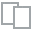
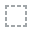
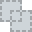
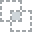
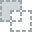
...
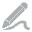
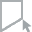
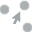
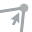
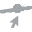

In [352]:
from dataprep.eda import create_report
report = create_report(df)
report


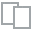
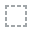
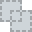
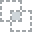
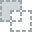
...
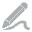
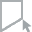
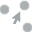
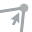
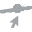

In [353]:
from dataprep.eda import plot
plot(df, "Codigo resultado","Nivel de contaminacion")


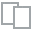
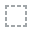
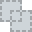
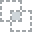
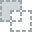
...
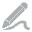
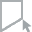
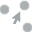
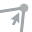
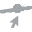

In [354]:
from dataprep.eda import plot
plot(df, "Marca","Nivel de contaminacion")


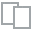
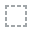
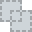
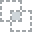
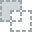
...
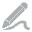
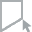
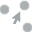
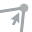
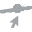

In [355]:
plot(df, "Linea","Nivel de contaminacion")


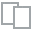
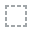
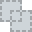
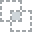
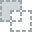
...
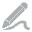
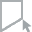
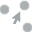
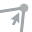
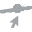

In [356]:
plot(df, "Modelo","Nivel de contaminacion")


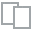
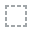
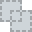
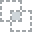
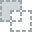
...
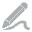
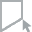
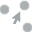
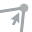
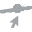

In [357]:
plot(df, "Combustible","Nivel de contaminacion")


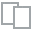
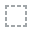
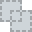
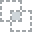
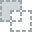
...
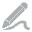
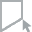
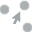
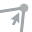
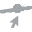

In [358]:
plot(df, "Cilindraje","Nivel de contaminacion")


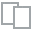
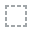
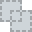
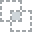
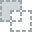
...
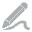
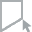
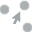
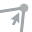
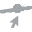

In [359]:
plot(df, "Kilometraje","Nivel de contaminacion")


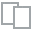
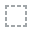
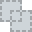
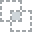
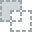
...
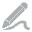
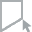
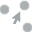
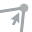
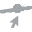

In [360]:
plot(df, "Gases  temperatura ambiente","Nivel de contaminacion")


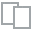
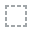
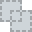
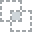
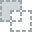
...
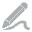
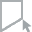
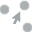
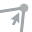
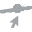

In [361]:
plot(df, "Gases  humedad relativa","Nivel de contaminacion")

In [363]:
for i in range(0,len(df)):
    
    if df.iloc[i,3] == 'RENAULT':
        df.iloc[i,3] = 1
    elif df.iloc[i,3] == 'MAZDA':
        df.iloc[i,3] = 2
    elif df.iloc[i,3] == 'CHEVROLET':
        df.iloc[i,3] = 3
    elif df.iloc[i,3] == 'TOYOTA':
        df.iloc[i,3] = 4
    elif df.iloc[i,3] == 'HYUNDAI':
        df.iloc[i,3] = 5
    elif df.iloc[i,3] == 'OTRA':
        df.iloc[i,3] =6
df['Marca']=pd.to_numeric(df['Marca'])

In [364]:
for i in range(0,len(df)):    
    if df.iloc[i,7] == 'GAS - GASOLINA':
        df.iloc[i,7] = 1
    elif df.iloc[i,7] == 'GAS NATURAL VEHICULAR':
        df.iloc[i,7] = 2
    elif df.iloc[i,7] == 'GASOLINA':
        df.iloc[i,7] = 3
    elif df.iloc[i,7] == 'GASOLINA - ELECTRICO':
        df.iloc[i,7] = 4
df['Combustible']=pd.to_numeric(df['Combustible'])

## Atípicos, Covarianza, # Condición, Determinante:

In [365]:
print(list(df.columns))

['Numero fur', 'Fecha inicio', 'Codigo resultado', 'Marca', 'Linea', 'Modelo', 'Fecha matricula', 'Combustible', 'Cilindraje', 'Kilometraje', 'Gases  temperatura ambiente', 'Gases  humedad relativa', 'Gases  convertidor catalitico', 'Gases  ralenti  rpm', 'Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  rpm', 'Gases  crucero  co', 'Gases  crucero  hc', 'Gases  crucero  co2', 'Gases  crucero  o2', 'Nivel de contaminacion', 'Clasificacion nivel de contaminacion']


In [366]:
# definir variables:
X = df[['Codigo resultado', 'Marca','Modelo','Combustible','Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  co', 'Gases  crucero  hc', 
        'Gases  crucero  co2', 'Gases  crucero  o2', 'Nivel de contaminacion', 'Clasificacion nivel de contaminacion']]
X.dtypes

Codigo resultado                          int64
Marca                                     int64
Modelo                                    int64
Combustible                               int64
Gases  ralenti  co                      float64
Gases  ralenti  hc                      float64
Gases  ralenti  co2                     float64
Gases  ralenti  o2                      float64
Gases  crucero  co                      float64
Gases  crucero  hc                      float64
Gases  crucero  co2                     float64
Gases  crucero  o2                      float64
Nivel de contaminacion                  float64
Clasificacion nivel de contaminacion      int64
dtype: object

Centralizar datos

In [367]:
X_centralizada = X - X.mean()

In [368]:
X_correlacion = np.corrcoef(X_centralizada,rowvar=False)# Crear matriz de correlación forma 1


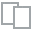
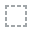
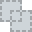
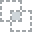
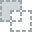
...
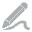
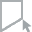
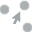
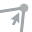
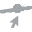

In [369]:
from dataprep.eda import plot_correlation
plot_correlation(X_centralizada)

In [370]:
matriz_cov = np.cov(X_centralizada, rowvar=False) 

In [371]:
determinante = np.linalg.det(matriz_cov) 
determinante

280042.1585151153

In [372]:
ncondicion = np.linalg.cond(matriz_cov) 
ncondicion

439713670.9496324

In [373]:
from sklearn.covariance import LedoitWolf
cov_LW = LedoitWolf().fit(X_centralizada)
cov_LW_encogida = cov_LW.covariance_ 

In [374]:
cov_LW_shrinkage = cov_LW.shrinkage_
cov_LW_shrinkage

0.04384637018486556

In [375]:
determinante_LW = np.linalg.det(cov_LW_encogida) 
determinante_LW

3.329682881740641e+46

In [376]:
ncondicion_LW = np.linalg.cond(cov_LW_encogida) 
ncondicion_LW

257.15176313170514

Indentificación de atípicos a través de distancias de Mahalanobis:

In [377]:
X_centralizada = X_centralizada.values
Número_filas, Número_columnas=X_centralizada.shape

Transpuesta=X_centralizada.transpose()
cov_LW_encogida=cov_LW_encogida
Inverso_covarianza=np.linalg.inv(cov_LW_encogida)
MD=np.zeros((Número_filas, 1))

for i in range(1,Número_filas):
    tem1=np.dot(X_centralizada[i,:],Inverso_covarianza)
    tem2=np.dot(tem1,Transpuesta[:,i])
    MD[i]=np.sqrt(tem2)

print('La distancia de Mahalanobis es: \n', MD)

La distancia de Mahalanobis es: 
 [[ 0.        ]
 [ 0.56631968]
 [ 0.46561107]
 ...
 [39.20725525]
 [27.71327871]
 [35.12280348]]


In [378]:
MD = pd.DataFrame(MD)
MD.columns = ['Distancias_Mahal']

In [379]:
corte = np.percentile(MD, 99.99)
corte

38.46324038107876

In [380]:
X_99 = []
X_99 = pd.concat([X,MD],axis=1)
X_99_corte = X_99['Distancias_Mahal'] < corte
X_99 = X_99[X_99_corte]
X_99.reset_index(drop=True, inplace=True)
X_99 = X_99.drop(['Distancias_Mahal'],axis=1)
X_99.head(2)

,Codigo resultado,Marca,Modelo,Combustible,Gases ralenti co,Gases ralenti hc,Gases ralenti co2,Gases ralenti o2,Gases crucero co,Gases crucero hc,Gases crucero co2,Gases crucero o2,Nivel de contaminacion,Clasificacion nivel de contaminacion
0,2,6,2009,3,0.0,2.0,15.4,0.0,0.0,4.0,15.3,0.0,0.4,1
1,2,6,2019,3,0.0,0.0,15.1,0.0,0.0,0.0,14.8,0.0,0.4,1



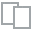
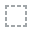
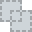
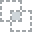
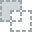
...
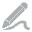
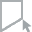
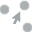
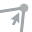
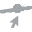

In [381]:
plot(X_99)

## Análisis PCA:

In [382]:
cov_LW99 = LedoitWolf().fit(X_99)
cov_LW99_encogida = cov_LW.covariance_ 

In [383]:
autovalor,autovector = np.linalg.eig(cov_LW99_encogida) 

In [384]:
autovalor.round(3)

array([273441.706,  53221.611,   1149.258,   1068.475,   1066.801,
         1066.473,   1063.986,   1064.053,   1063.605,   1063.57 ,
         1063.495,   1063.397,   1063.365,   1063.348])

In [385]:
autovector.round(3)

array([[ 0.   ,  0.   ,  0.008, -0.072, -0.007,  0.   , -0.029, -0.002,
        -0.341,  0.225,  0.909, -0.002,  0.009, -0.   ],
       [-0.   , -0.   ,  0.004,  0.076,  0.363,  0.929, -0.007, -0.01 ,
        -0.013,  0.004,  0.002,  0.007, -0.   ,  0.   ],
       [-0.006,  0.001, -0.988, -0.148, -0.041,  0.032, -0.007, -0.008,
        -0.002, -0.001, -0.004, -0.001, -0.001, -0.   ],
       [-0.   , -0.   , -0.003,  0.004,  0.029, -0.019,  0.001,  0.043,
        -0.175, -0.222, -0.008,  0.957, -0.03 ,  0.003],
       [ 0.001, -0.   ,  0.053, -0.466,  0.278, -0.067,  0.614, -0.189,
        -0.066, -0.261,  0.021, -0.061,  0.334, -0.312],
       [ 0.817, -0.577, -0.006,  0.004,  0.   , -0.   , -0.001, -0.   ,
         0.   ,  0.001, -0.   ,  0.   , -0.   , -0.006],
       [-0.002,  0.   , -0.07 ,  0.38 ,  0.31 , -0.158, -0.382, -0.134,
        -0.341, -0.375, -0.02 , -0.141,  0.536,  0.047],
       [ 0.001, -0.   ,  0.048, -0.108, -0.645,  0.266, -0.002,  0.502,
        -0.134, -0.274,  

In [386]:
#Proporción de los autovalores:
proporcion=autovalor/sum(autovalor)
proporcion

array([0.80536985, 0.156754  , 0.00338492, 0.00314699, 0.00314206,
       0.00314109, 0.00313377, 0.00313396, 0.00313264, 0.00313254,
       0.00313232, 0.00313203, 0.00313194, 0.00313189])

In [387]:
0.80532972 + 0.15696405 # 96% de la variabilidad de los datos en 2 dimensiones

0.96229377

In [388]:
#Se procede a extraer la columna 1 ya que es el vector de proyección de la máxima sombra, así:
vector_proyeccion=autovector[:,1]

In [389]:
# Forma 2 PCA
from sklearn.decomposition import PCA

# Instanciar número de componentes
n_componentes = 13 # intuición
pca = PCA(n_components = n_componentes)
pca

PCA(n_components=13)

In [390]:
X_PCA = pca.fit_transform(cov_LW_encogida) 
X_PCA = pd.DataFrame(X_PCA)

In [391]:
pca.explained_variance_ratio_

array([9.57828713e-01, 4.19829520e-02, 1.95114605e-05, 1.69907148e-05,
       1.69509941e-05, 1.69299280e-05, 1.68644161e-05, 1.68624063e-05,
       1.68495594e-05, 1.68469367e-05, 1.68437831e-05, 1.68427289e-05,
       1.68421797e-05])

In [392]:
sum(pca.explained_variance_ratio_)

1.0000000000000002

In [393]:
sum(pca.explained_variance_ratio_[:1])

0.9578287128465874

In [394]:
X_99.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9225 entries, 0 to 9224
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Codigo resultado                      9225 non-null   int64  
 1   Marca                                 9225 non-null   int64  
 2   Modelo                                9225 non-null   int64  
 3   Combustible                           9225 non-null   int64  
 4   Gases  ralenti  co                    9225 non-null   float64
 5   Gases  ralenti  hc                    9225 non-null   float64
 6   Gases  ralenti  co2                   9225 non-null   float64
 7   Gases  ralenti  o2                    9225 non-null   float64
 8   Gases  crucero  co                    9225 non-null   float64
 9   Gases  crucero  hc                    9225 non-null   float64
 10  Gases  crucero  co2                   9225 non-null   float64
 11  Gases  crucero  o

## Modelos de clasificación:

#### K - Nearest Neighbors:

In [395]:
X = X_99[[ 'Marca','Modelo','Combustible','Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  co', 'Gases  crucero  hc', 
        'Gases  crucero  co2', 'Gases  crucero  o2']]

In [396]:
y = X_99[['Clasificacion nivel de contaminacion']]

In [397]:
print(X.shape, y.shape)

(9225, 11) (9225, 1)


In [398]:
from sklearn.model_selection import train_test_split
# separar los datos en train y eval
x_train, x_eval, y_train, y_eval = train_test_split(X, y, test_size=0.20, train_size=0.80, random_state=0)

In [399]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

import seaborn as sb
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')


from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix


scaler = MinMaxScaler() #para normalizar
x_train = scaler.fit_transform(x_train)
x_eval = scaler.transform(x_eval)

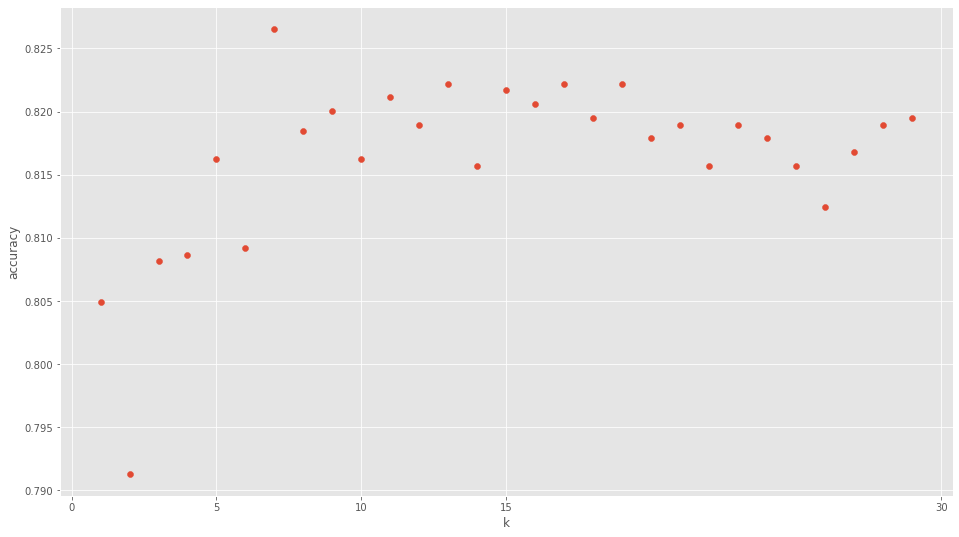

In [400]:
import warnings
warnings.filterwarnings('ignore')

k_range = range(1, 30)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(x_train, y_train)
    scores.append(knn.score(x_eval, y_eval))
plt.figure()
plt.xlabel('k')
plt.ylabel('accuracy')
plt.scatter(k_range, scores)
plt.xticks([0,5,10,15,30]);

In [401]:
n_neighbors = 7

knn = KNeighborsClassifier(n_neighbors)
knn.fit(x_train, y_train)
print('Precisión del clasificador K-NN en el conjunto de entrenamiento: {:.2f}'
     .format(knn.score(x_train, y_train)))
print('Precisión del clasificador K-NN en el conjunto de prueba: {:.2f}'
     .format(knn.score(x_eval, y_eval)))

Precisión del clasificador K-NN en el conjunto de entrenamiento: 0.85
Precisión del clasificador K-NN en el conjunto de prueba: 0.83


In [402]:
pred = knn.predict(x_eval)
print('\n')
print(confusion_matrix(y_eval, pred))
print('\n')
print(classification_report(y_eval, pred))



[[ 172   70    0    0    0]
 [  86 1237    5    5    1]
 [   0   57   17   10    2]
 [   0   33   15   49   10]
 [   0   15    3    8   50]]


              precision    recall  f1-score   support

           1       0.67      0.71      0.69       242
           2       0.88      0.93      0.90      1334
           3       0.42      0.20      0.27        86
           4       0.68      0.46      0.55       107
           5       0.79      0.66      0.72        76

    accuracy                           0.83      1845
   macro avg       0.69      0.59      0.63      1845
weighted avg       0.81      0.83      0.82      1845



In [403]:
confusion_matrixV = confusion_matrix(y_eval, pred)
confusion_matrixV = pd.DataFrame(confusion_matrixV)

verdaderos_positivos = np.diag(confusion_matrixV)
falsos_positivos = confusion_matrixV.sum(axis=0) - verdaderos_positivos
falsos_negativos = confusion_matrixV.sum(axis=1) - verdaderos_positivos
verdaderos_negativos = (confusion_matrixV.to_numpy().sum() - (verdaderos_positivos + falsos_positivos + falsos_negativos))

confusion_matrixV.columns = ['Nivel 1','Nivel 2','Nivel 3','Nivel 4','Nivel 5']

for dato, vp, fp, vn, fn in zip(
    confusion_matrixV.columns,
    verdaderos_positivos, falsos_positivos,
    verdaderos_negativos, falsos_negativos):

    frame = pd.DataFrame.from_dict(
        {"Positive(1)": (vp, fp), "Negative(0)": (fn, vn)},
        orient="Index",
        columns=("Positive(1)", "Negative(0)"))
    
    frame.index.name = f'Predicted Values for "{dato}"'
    frame.columns.name = f'Actual values for "{dato}"'
    print(frame, "\n")

Actual values for "Nivel 1"     Positive(1)  Negative(0)
Predicted Values for "Nivel 1"                          
Positive(1)                             172           86
Negative(0)                              70         1517 

Actual values for "Nivel 2"     Positive(1)  Negative(0)
Predicted Values for "Nivel 2"                          
Positive(1)                            1237          175
Negative(0)                              97          336 

Actual values for "Nivel 3"     Positive(1)  Negative(0)
Predicted Values for "Nivel 3"                          
Positive(1)                              17           23
Negative(0)                              69         1736 

Actual values for "Nivel 4"     Positive(1)  Negative(0)
Predicted Values for "Nivel 4"                          
Positive(1)                              49           23
Negative(0)                              58         1715 

Actual values for "Nivel 5"     Positive(1)  Negative(0)
Predicted Values for "N

#### ÁRBOL DE DECISIÓN:

In [407]:
X = X_99[[ 'Marca','Modelo','Combustible','Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  co', 'Gases  crucero  hc', 
        'Gases  crucero  co2', 'Gases  crucero  o2']]

In [408]:
y = X_99[['Clasificacion nivel de contaminacion']]

In [409]:
print(X.shape, y.shape)

(9225, 11) (9225, 1)


In [410]:
from sklearn.model_selection import train_test_split
# separar los datos en train y eval
x_train, x_eval, y_train, y_eval = train_test_split(X, y, test_size=0.20, train_size=0.80, random_state=0)

In [411]:
from sklearn.tree import DecisionTreeClassifier
# creando el modelo sin control de profundidad, crecerá hasta que todas las hojas sean puras
arbol = DecisionTreeClassifier(criterion = 'gini')
# ajustando el modelo
arbol.fit(x_train, y_train)

DecisionTreeClassifier()

In [412]:
from sklearn.tree import export_graphviz
from graphviz import Source 
import os
# estructura del árbol creado en el paso anterior:
print(f"Profundidad del árbol: {arbol.get_depth()}")
print(f"Número de nodos terminales: {arbol.get_n_leaves()}")

Profundidad del árbol: 17
Número de nodos terminales: 344


In [413]:
# precisión del modelo en datos de entrenamiento.
print("precisión entranamiento: {0: .2f}".format(
        arbol.score(x_train, y_train)))

precisión entranamiento:  1.00


In [414]:
# precisión del modelo en datos de evaluación.
print("precisión evaluación: {0: .2f}".format(arbol.score(x_eval, y_eval)))

precisión evaluación:  0.93


In [415]:
# profundidad del arbol de decisión
arbol.tree_.max_depth

17

Debemos reducir la complejidad del modelo para intentar ganar en generalización. También debemos tener en cuenta que si reducimos demasiado la complejidad, podemos crear un modelo demasiado simple que en vez de estar sobreajustado puede tener un desempeño muy por debajo del que podría tener; podríamos decir que el modelo estaría infraajustado y tendría un alto nivel de sesgo. Para ayudarnos a encontrar el término medio entre la complejidad del modelo y su ajuste a los datos, podemos ayudarnos de herramientas gráficas. Por ejemplo podríamos crear diferentes modelos, con distintos grados de complejidad y luego graficar la precisión en función de la complejidad.

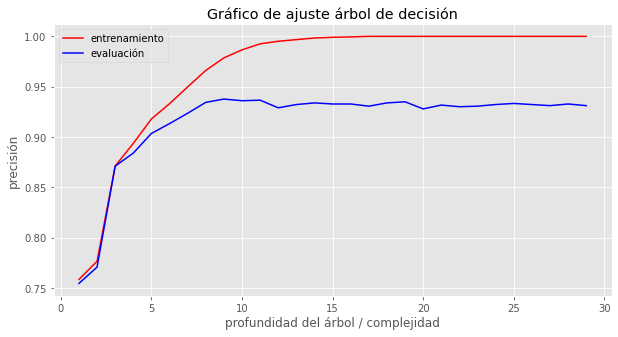

In [416]:
import matplotlib.pyplot as plt
# Gráfico de ajuste del árbol de decisión
fig, ax = plt.subplots(figsize=(10, 5))
train_prec =  []
eval_prec = []
max_deep_list = list(range(1,30))

for deep in max_deep_list:
    arbol3 = DecisionTreeClassifier(criterion='gini', max_depth=deep)
    arbol3.fit(x_train, y_train)
    train_prec.append(arbol3.score(x_train, y_train))
    eval_prec.append(arbol3.score(x_eval, y_eval))

# graficar los resultados.
plt.plot(max_deep_list, train_prec, color='r', label='entrenamiento')
plt.plot(max_deep_list, eval_prec, color='b', label='evaluación')
plt.title('Gráfico de ajuste árbol de decisión')
plt.legend()
plt.ylabel('precisión')
plt.xlabel('profundidad del árbol / complejidad')
plt.show()

El gráfico que acabamos de construir muestra la precisión del modelo en función de su complejidad.Podemos observar que el punto con mayor precisión, en los datos de evaluación, lo obtenemos con un nivel de profundidad menor a 10.

In [417]:
# modelo dos, con control de profundidad
arbol2 = DecisionTreeClassifier(criterion='gini', max_depth=4)

# Ajustando el modelo
arbol2.fit(x_train, y_train)

DecisionTreeClassifier(max_depth=4)

Profundidad del árbol: 4
Número de nodos terminales: 16


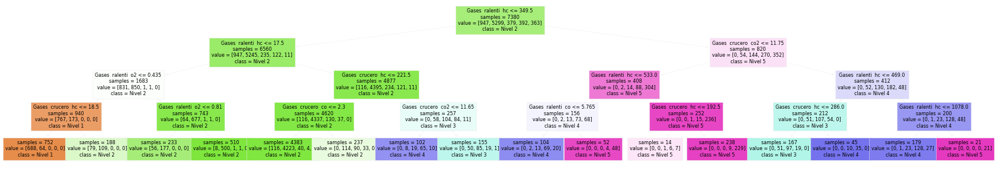

In [418]:
from sklearn.tree import plot_tree
import pydotplus
# Estructura del árbol creado
# ------------------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 5))

print(f"Profundidad del árbol: {arbol2.get_depth()}")
print(f"Número de nodos terminales: {arbol2.get_n_leaves()}")

plot = plot_tree(
            decision_tree = arbol2,
            feature_names = X.columns,
            class_names   = ['Nivel 1','Nivel 2','Nivel 3','Nivel 4','Nivel 5'],
            filled        = True,
            impurity      = False,
            fontsize      = 8,
            ax            = ax
       )

In [419]:
# guardar png del árbol2:
import pydotplus

print(f"Profundidad del árbol: {arbol2.get_depth()}")
print(f"Número de nodos terminales: {arbol2.get_n_leaves()}")
labels = list(X.columns)
data = export_graphviz(decision_tree = arbol2,
                       feature_names = X.columns,
                       class_names   = ['Nivel 1','Nivel 2','Nivel 3','Nivel 4','Nivel 5'],
                       rounded       = True,
                       filled        = True)   
graph = pydotplus.graph_from_dot_data(data)
graph.write_png('Árbol_decisión_CDA.png')

Profundidad del árbol: 4
Número de nodos terminales: 16


True

In [420]:
from sklearn.tree import export_text
texto_modelo = export_text(decision_tree = arbol2, feature_names = list(X.columns))
print(texto_modelo)

|--- Gases  ralenti  hc <= 349.50
|   |--- Gases  ralenti  hc <= 17.50
|   |   |--- Gases  ralenti  o2 <= 0.44
|   |   |   |--- Gases  crucero  hc <= 18.50
|   |   |   |   |--- class: 1
|   |   |   |--- Gases  crucero  hc >  18.50
|   |   |   |   |--- class: 2
|   |   |--- Gases  ralenti  o2 >  0.44
|   |   |   |--- Gases  ralenti  o2 <= 0.81
|   |   |   |   |--- class: 2
|   |   |   |--- Gases  ralenti  o2 >  0.81
|   |   |   |   |--- class: 2
|   |--- Gases  ralenti  hc >  17.50
|   |   |--- Gases  crucero  hc <= 221.50
|   |   |   |--- Gases  crucero  co <= 2.30
|   |   |   |   |--- class: 2
|   |   |   |--- Gases  crucero  co >  2.30
|   |   |   |   |--- class: 2
|   |   |--- Gases  crucero  hc >  221.50
|   |   |   |--- Gases  crucero  co2 <= 11.65
|   |   |   |   |--- class: 4
|   |   |   |--- Gases  crucero  co2 >  11.65
|   |   |   |   |--- class: 3
|--- Gases  ralenti  hc >  349.50
|   |--- Gases  crucero  co2 <= 11.75
|   |   |--- Gases  ralenti  hc <= 533.00
|   |   |   |---

In [421]:
# precisión del modelo en datos de entrenamiento.
print("precisión entrenamiento: {0: .2f}".format(
        arbol2.score(x_train, y_train)))

precisión entrenamiento:  0.89


In [422]:
# precisión del modelo en datos de evaluación.
print("precisión evaluación: {0: .2f}".format(
        arbol2.score(x_eval, y_eval)))

precisión evaluación:  0.88


In [423]:
y_pred = arbol2.predict(x_eval)
print(confusion_matrix(y_eval, y_pred))

[[ 172   70    0    0    0]
 [  15 1288   30    1    0]
 [   0   28   43   15    0]
 [   0   16   14   70    7]
 [   0    0    1   17   58]]


In [424]:
matriz_confusion = confusion_matrix(y_eval, y_pred)
matriz_confusion = pd.DataFrame(matriz_confusion)

verdaderos_positivos = np.diag(matriz_confusion)
falsos_positivos = matriz_confusion.sum(axis=0) - verdaderos_positivos
falsos_negativos = matriz_confusion.sum(axis=1) - verdaderos_positivos
verdaderos_negativos = (matriz_confusion.to_numpy().sum() - (verdaderos_positivos + falsos_positivos + falsos_negativos))

matriz_confusion.columns = ['Nivel 1','Nivel 2','Nivel 3','Nivel 4','Nivel 5']

for dato, vp, fp, vn, fn in zip(
    matriz_confusion.columns,
    verdaderos_positivos, falsos_positivos,
    verdaderos_negativos, falsos_negativos):

    frame = pd.DataFrame.from_dict(
        {"Positive(1)": (vp, fp), "Negative(0)": (fn, vn)},
        orient="Index",
        columns=("Positive(1)", "Negative(0)"))
    
    frame.index.name = f'Predicted Values for "{dato}"'
    frame.columns.name = f'Actual values for "{dato}"'
    print(frame, "\n")

Actual values for "Nivel 1"     Positive(1)  Negative(0)
Predicted Values for "Nivel 1"                          
Positive(1)                             172           15
Negative(0)                              70         1588 

Actual values for "Nivel 2"     Positive(1)  Negative(0)
Predicted Values for "Nivel 2"                          
Positive(1)                            1288          114
Negative(0)                              46          397 

Actual values for "Nivel 3"     Positive(1)  Negative(0)
Predicted Values for "Nivel 3"                          
Positive(1)                              43           45
Negative(0)                              43         1714 

Actual values for "Nivel 4"     Positive(1)  Negative(0)
Predicted Values for "Nivel 4"                          
Positive(1)                              70           33
Negative(0)                              37         1705 

Actual values for "Nivel 5"     Positive(1)  Negative(0)
Predicted Values for "N

In [425]:
from sklearn.metrics import classification_report
print(classification_report(y_eval, y_pred));

              precision    recall  f1-score   support

           1       0.92      0.71      0.80       242
           2       0.92      0.97      0.94      1334
           3       0.49      0.50      0.49        86
           4       0.68      0.65      0.67       107
           5       0.89      0.76      0.82        76

    accuracy                           0.88      1845
   macro avg       0.78      0.72      0.75      1845
weighted avg       0.88      0.88      0.88      1845



Otra herramienta analítica que nos ayuda a entender como reducimos el Sobreajuste con la ayuda de más datos, son las curvas de aprendizaje, las cuales grafican la precisión en función del tamaño de los datos de entrenamiento.

In [426]:
# Curvas de aprendizaje
from sklearn.model_selection import learning_curve

train_sizes, train_scores, test_scores = learning_curve(estimator=arbol, X=x_train, y=y_train, 
                                                        train_sizes=np.linspace(0.1, 1.0, 10), 
                                                        n_jobs=-1)
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

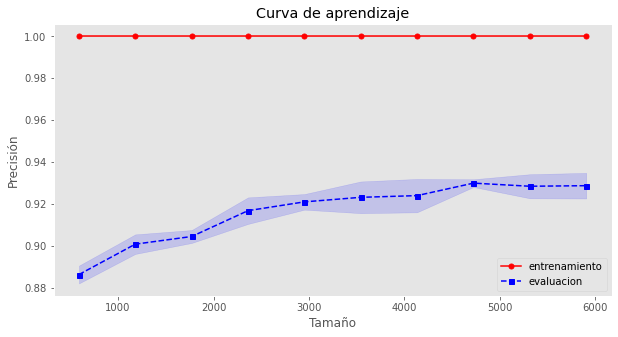

In [427]:
# graficando las curvas
fig, ax = plt.subplots(figsize=(10, 5))
plt.plot(train_sizes, train_mean, color='r', marker='o', markersize=5,
         label='entrenamiento')
plt.fill_between(train_sizes, train_mean + train_std, 
                 train_mean - train_std, alpha=0.15, color='r')
plt.plot(train_sizes, test_mean, color='b', linestyle='--', 
         marker='s', markersize=5, label='evaluacion')
plt.fill_between(train_sizes, test_mean + test_std, 
                 test_mean - test_std, alpha=0.15, color='b')
plt.grid()
plt.title('Curva de aprendizaje')
plt.legend(loc='best')
plt.xlabel('Tamaño')
plt.ylabel('Precisión')
plt.show()

En este gráfico podemos ver claramente como con pocos datos, la precisión entre los datos de entrenamiento y los de evaluación son muy distintas y luego a medida que la cantidad de datos va aumentando, el modelo puede generalizar mucho mejor y las precisiones se comienzan a emparejar.

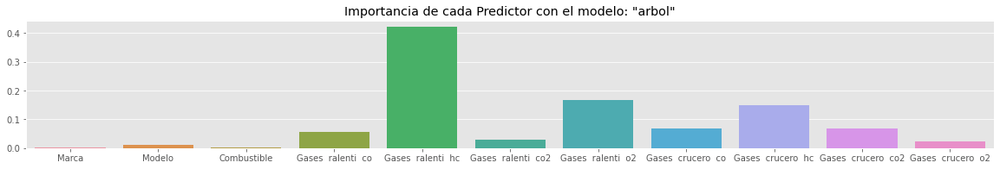

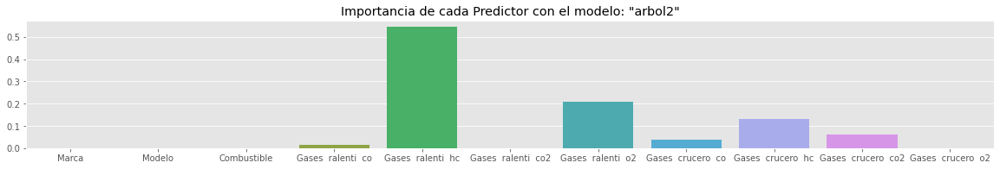

In [428]:
# Gráfico de importancia de los predictores en los modelos: arbol y arbol2
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
style.use('ggplot') or plt.style.use('ggplot')

# visualizar importancia con el modelo 'arbol':
fig, ax = plt.subplots(figsize=(20, 6))
plt.subplot(2, 1, 1)
x = X.columns
y1 = arbol.feature_importances_ #importancia de cada variable predictora
sns.barplot(x=x, y=y1)
plt.title('Importancia de cada Predictor con el modelo: "arbol"')

# visualizar importancia con el modelo 'arbol2':
fig, ax = plt.subplots(figsize=(20, 6))
plt.subplot(2, 1, 2)
y2 = arbol2.feature_importances_ #importancia de cada variable predictora
sns.barplot(x=x, y=y2)
plt.title('Importancia de cada Predictor con el modelo: "arbol2"')
plt.show()

In [429]:
# predictores del modelo "arbol" vs arbol2" en orden de importancia:
importancia = pd.DataFrame({'Predictor':list(X.columns),'Importancia_arbol':np.round(arbol.feature_importances_,3),'Importancia_arbol2':np.round(arbol2.feature_importances_,3)})
importancia = importancia.sort_values('Importancia_arbol2',ascending=False)
importancia

,Predictor,Importancia_arbol,Importancia_arbol2
4,Gases ralenti hc,0.423,0.547
6,Gases ralenti o2,0.167,0.207
8,Gases crucero hc,0.151,0.129
9,Gases crucero co2,0.068,0.063
7,Gases crucero co,0.068,0.040
3,Gases ralenti co,0.055,0.014
0,Marca,0.003,0.000
1,Modelo,0.012,0.000
2,Combustible,0.001,0.000
5,Gases ralenti co2,0.030,0.000


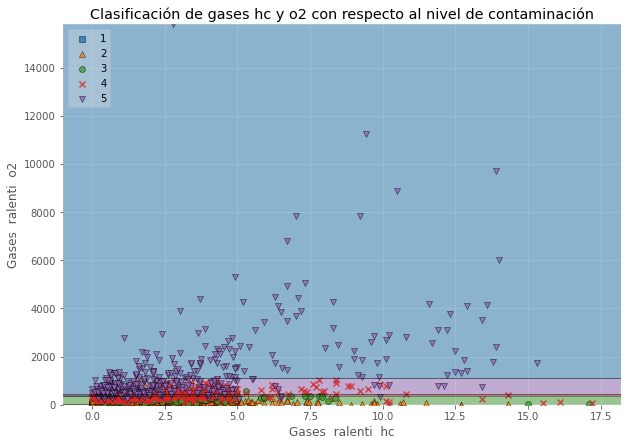

In [430]:
from mlxtend.plotting import plot_decision_regions
# regiones de decisión en 2D con las variables más representativas del modelo final ("arbol2"):
X= pd.concat([X_99['Gases  ralenti  hc'],X_99['Gases  ralenti  o2']], axis=1)
y = X_99['Clasificacion nivel de contaminacion']

X2 = X.iloc[:,[1,0]].values # variable 1 = Gases ralenti hc ; variable 3 = Gases ralenti o2
y2 = y.iloc[:].values       # variable respuesta = Clasificacion nivel de contaminacion
arbol2.fit(X2,y2)           # usamos el arbol2 resultante en el modelo final
fig, ax = plt.subplots(figsize=(10, 7))
plot_decision_regions(X2, y2, clf=arbol2, legend=2)
plt.xlabel('Gases  ralenti  hc')
plt.ylabel('Gases  ralenti  o2')
plt.title('Clasificación de gases hc y o2 con respecto al nivel de contaminación')
plt.show()

#### MÁQUINA DE SOPORTE VECTORIAL:

In [431]:
X = X_99[[ 'Marca','Modelo','Combustible','Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  co', 'Gases  crucero  hc', 
        'Gases  crucero  co2', 'Gases  crucero  o2']]


In [432]:
y = X_99[['Clasificacion nivel de contaminacion']]

In [433]:
print(X.shape, y.shape)

(9225, 11) (9225, 1)


In [434]:
from sklearn.model_selection import train_test_split
# separar los datos en train y eval
x_train, x_eval, y_train, y_eval = train_test_split(X, y, test_size=0.20, train_size=0.80, random_state=0)

In [435]:
from sklearn.svm import SVC
algoritmo=SVC(kernel='linear')

In [436]:
algoritmo.fit(x_train, y_train)

SVC(kernel='linear')

In [437]:
y_pred=algoritmo.predict(x_eval)

In [438]:
matriz_SVC=confusion_matrix(y_eval,y_pred)
print('Matriz de confusión: ')
print(matriz_SVC)

Matriz de confusión: 
[[ 232   10    0    0    0]
 [  12 1322    0    0    0]
 [   0    1   84    1    0]
 [   0    0    0  105    2]
 [   0    0    0    0   76]]


In [439]:
print('Precisión del clasificador en el conjunto de entrenamiento: {:.2f}'
     .format(algoritmo.score(x_train, y_train)))
print('Precisión del clasificador en el conjunto de prueba: {:.2f}'
     .format(algoritmo.score(x_eval, y_eval)))

Precisión del clasificador en el conjunto de entrenamiento: 0.98
Precisión del clasificador en el conjunto de prueba: 0.99


#### RED NEURONAL:

In [440]:
X = X_99[[ 'Marca','Modelo','Combustible','Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  co', 'Gases  crucero  hc', 
        'Gases  crucero  co2', 'Gases  crucero  o2']]

In [441]:
y = X_99[['Clasificacion nivel de contaminacion']]

In [442]:
from sklearn.model_selection import train_test_split
# separar los datos en train y eval
x_train, x_eval, y_train, y_eval = train_test_split(X, y, test_size=0.20, train_size=0.80, random_state=0)

In [443]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(solver='adam', alpha=0.0001,
                     hidden_layer_sizes=(10, 10, 10,10,10), random_state=0, max_iter=500, tol=0.0000000001)

clf.fit(x_train, y_train)
predictions=clf.predict(x_eval)

In [444]:
from sklearn.metrics import classification_report
print(classification_report(y_eval,predictions));

              precision    recall  f1-score   support

           1       0.84      0.96      0.90       242
           2       0.99      0.97      0.98      1334
           3       0.99      0.88      0.93        86
           4       0.94      0.94      0.94       107
           5       0.94      1.00      0.97        76

    accuracy                           0.96      1845
   macro avg       0.94      0.95      0.94      1845
weighted avg       0.97      0.96      0.96      1845



#### REGRESIÓN LINEAL MÚLTIPLE:

In [462]:
X = X_99[[ 'Marca','Modelo','Combustible','Gases  ralenti  co', 'Gases  ralenti  hc', 'Gases  ralenti  co2', 'Gases  ralenti  o2', 'Gases  crucero  co', 'Gases  crucero  hc', 
        'Gases  crucero  co2', 'Gases  crucero  o2']]

In [463]:
y = X_99[['Clasificacion nivel de contaminacion']]

In [464]:
from sklearn.model_selection import train_test_split
# separar los datos en train y eval
x_train, x_eval, y_train, y_eval = train_test_split(X, y, test_size=0.20, train_size=0.80, random_state=0)

In [465]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.anova import anova_lm
from scipy import stats

In [466]:
# A la matriz de predictores se le tiene que añadir una columna de 1s para el intercept del modelo
x_train_reg = sm.add_constant(x_train, prepend=True)
modelo = sm.OLS(endog=y_train, exog=x_train_reg,)
modelo = modelo.fit()
print(modelo.summary())

                                     OLS Regression Results                                     
Dep. Variable:     Clasificacion nivel de contaminacion   R-squared:                       0.697
Model:                                              OLS   Adj. R-squared:                  0.696
Method:                                   Least Squares   F-statistic:                     1537.
Date:                                  Mon, 07 Jun 2021   Prob (F-statistic):               0.00
Time:                                          17:50:24   Log-Likelihood:                -5264.6
No. Observations:                                  7380   AIC:                         1.055e+04
Df Residuals:                                      7368   BIC:                         1.064e+04
Df Model:                                            11                                         
Covariance Type:                              nonrobust                                         
                          coef

In [467]:
# Diagnóstico errores (residuos) de las predicciones de entrenamiento
y_train = y_train.values
y_train=y_train.flatten()
prediccion_train = modelo.predict(exog = x_train_reg)
residuos_train   = prediccion_train - y_train

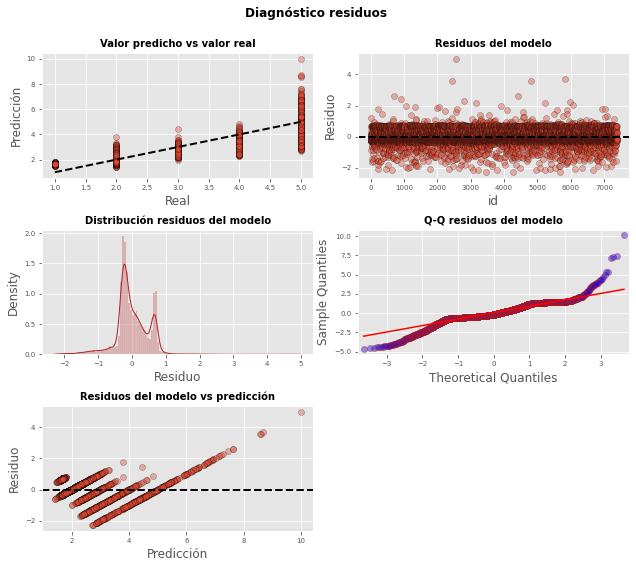

In [468]:
import seaborn as sns
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(9, 8))

axes[0, 0].scatter(y_train, prediccion_train, edgecolors=(0, 0, 0), alpha = 0.4)
axes[0, 0].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()],
                'k--', color = 'black', lw=2)
axes[0, 0].set_title('Valor predicho vs valor real', fontsize = 10, fontweight = "bold")
axes[0, 0].set_xlabel('Real')
axes[0, 0].set_ylabel('Predicción')
axes[0, 0].tick_params(labelsize = 7)

axes[0, 1].scatter(list(range(len(y_train))), residuos_train,
                   edgecolors=(0, 0, 0), alpha = 0.4)
axes[0, 1].axhline(y = 0, linestyle = '--', color = 'black', lw=2)
axes[0, 1].set_title('Residuos del modelo', fontsize = 10, fontweight = "bold")
axes[0, 1].set_xlabel('id')
axes[0, 1].set_ylabel('Residuo')
axes[0, 1].tick_params(labelsize = 7)

sns.histplot(
    data    = residuos_train,
    stat    = "density",
    kde     = True,
    line_kws= {'linewidth': 1},
    color   = "firebrick",
    alpha   = 0.3,
    ax      = axes[1, 0]
)

axes[1, 0].set_title('Distribución residuos del modelo', fontsize = 10,
                     fontweight = "bold")
axes[1, 0].set_xlabel("Residuo")
axes[1, 0].tick_params(labelsize = 7)


sm.qqplot(
    residuos_train,
    fit   = True,
    line  = 'q',
    ax    = axes[1, 1], 
    color = 'firebrick',
    alpha = 0.4,
    lw    = 2
)
axes[1, 1].set_title('Q-Q residuos del modelo', fontsize = 10, fontweight = "bold")
axes[1, 1].tick_params(labelsize = 7)

axes[2, 0].scatter(prediccion_train, residuos_train,
                   edgecolors=(0, 0, 0), alpha = 0.4)
axes[2, 0].axhline(y = 0, linestyle = '--', color = 'black', lw=2)
axes[2, 0].set_title('Residuos del modelo vs predicción', fontsize = 10, fontweight = "bold")
axes[2, 0].set_xlabel('Predicción')
axes[2, 0].set_ylabel('Residuo')
axes[2, 0].tick_params(labelsize = 7)

# Se eliminan los axes vacíos
fig.delaxes(axes[2,1])

fig.tight_layout()
plt.subplots_adjust(top=0.9)
fig.suptitle('Diagnóstico residuos', fontsize = 12, fontweight = "bold");

In [469]:
# Normalidad de los residuos Shapiro-Wilk test
# ==============================================================================
shapiro_test = stats.shapiro(residuos_train);
shapiro_test

ShapiroResult(statistic=0.9231351613998413, pvalue=0.0)

In [470]:
# Normalidad de los residuos D'Agostino's K-squared test
# ==============================================================================
k2, p_value = stats.normaltest(residuos_train)
print(f"Estadítico= {k2}, p-value = {p_value}")

Estadítico= 785.1989262249446, p-value = 3.134870262040877e-171


In [471]:
# Error de test del modelo 
from sklearn.metrics import mean_squared_error
# ==============================================================================
x_eval = sm.add_constant(x_eval, prepend=True)
predicciones = modelo.predict(exog = x_eval)
rmse = mean_squared_error(
        y_true  = y_eval,
        y_pred  = predicciones,
        squared = False
       )
print("")
print(f"El error (rmse) de test es: {rmse}")


El error (rmse) de test es: 0.5175718718686321


## Resultados:

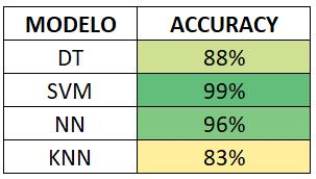

## Pruebas:

In [472]:
prueba = pd.read_excel('prueba_RN.xlsx')
prueba

,Marca,Modelo,Combustible,Gases ralenti co,Gases ralenti hc,Gases ralenti co2,Gases ralenti o2,Gases crucero co,Gases crucero hc,Gases crucero co2,Gases crucero o2
0,6,1974,1,0.00,450,8.90,0.84,0.00,331,8.78,0.50
1,6,1974,1,3.10,1674,5.54,7.31,0.23,775,9.33,4.99
2,6,2014,3,0.00,20,14.60,0.13,0.03,21,14.60,0.22
3,3,2013,3,0.00,12,14.60,0.11,0.00,14,14.50,0.19
4,3,2011,3,0.00,11,14.50,0.44,0.02,11,14.70,0.13
...,...,...,...,...,...,...,...,...,...,...,...
235,6,2013,3,0.00,13,14.70,0.15,0.00,18,14.60,0.14
236,6,2007,3,0.00,56,14.90,0.16,0.07,49,14.70,0.16
237,6,1997,3,1.77,244,13.00,0.96,1.30,114,13.40,0.91
238,6,1997,3,1.56,253,12.10,2.53,3.07,160,11.90,1.32


In [473]:
# KNN:
P_KNN = knn.predict(prueba)
P_KNN = pd.DataFrame(P_KNN)
P_KNN.to_excel('P_KNN.xlsx')

In [343]:
# ÁRBOL DECISIÓN:
P_DT = arbol2.predict(prueba)
P_DT = pd.DataFrame(P_DT)
P_DT.to_excel('P_DT.xlsx')

In [474]:
# MÁQUINA VECTOR SOPORTE:
P_SVM = algoritmo.predict(prueba)
P_SVM = pd.DataFrame(P_SVM)
P_SVM.to_excel('P_SVM.xlsx')

In [476]:
# RED NEURONAL:
P_NN = clf.predict(prueba)
P_NN = pd.DataFrame(P_NN)
P_NN.to_excel('P_NN.xlsx')

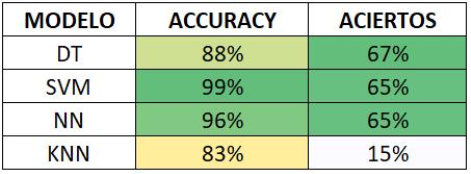



Evaluación del modelo de Árboles de decisión con las 3 variables más importantes: 
---------------------------------------------------------------------------------
Precisión entrenamiento:  0.88
---------------------------------------------------------------------------------
Precisión evaluación:  0.87
---------------------------------------------------------------------------------


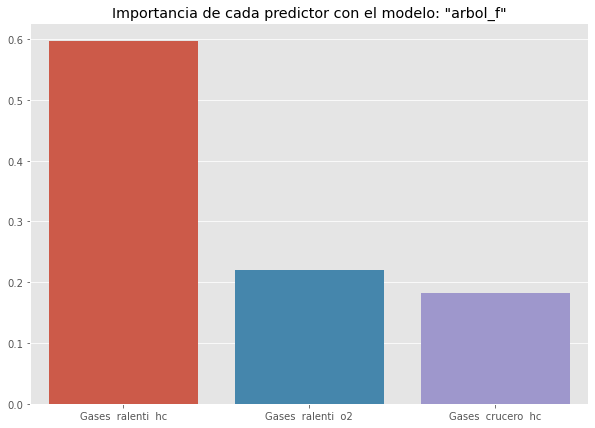

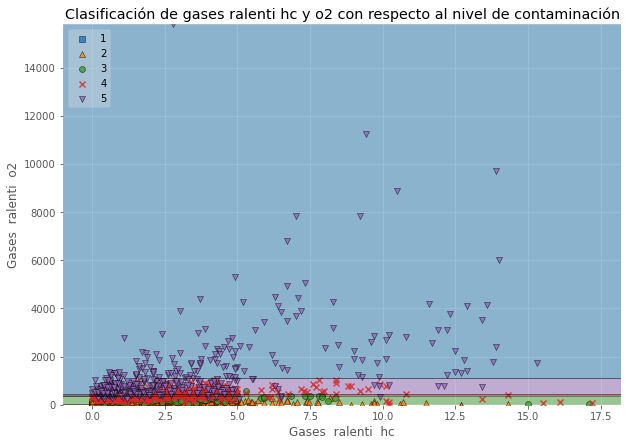

In [516]:
Xf = X_99[[ 'Gases  ralenti  hc','Gases  ralenti  o2', 'Gases  crucero  hc']]
yf = X_99[['Clasificacion nivel de contaminacion']]

# separar los datos en train y eval
x_train, x_eval, y_train, y_eval = train_test_split(Xf, yf, test_size=0.20, train_size=0.80, random_state=0)
arbol_f = DecisionTreeClassifier(criterion='gini', max_depth=4)

# Ajustando el modelo
arbol_f.fit(x_train, y_train)
print('\n')
print('Evaluación del modelo de Árboles de decisión con las 3 variables más importantes: ')

print('---------------------------------------------------------------------------------')
# precisión del modelo en datos de entrenamiento.
print("Precisión entrenamiento: {0: .2f}".format(
        arbol_f.score(x_train, y_train)))

print('---------------------------------------------------------------------------------')
# precisión del modelo en datos de evaluación.
print("Precisión evaluación: {0: .2f}".format(
        arbol_f.score(x_eval, y_eval)))

print('---------------------------------------------------------------------------------')
# Gráfico de importancia de los 3 predictores más importantes:
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
style.use('ggplot') or plt.style.use('ggplot')

# visualizar importancia con el modelo 'arbol_f':
fig, ax = plt.subplots(figsize=(10, 7))
x = Xf.columns
y1 = arbol_f.feature_importances_ #importancia de cada variable predictora
sns.barplot(x=x, y=y1)
plt.title('Importancia de cada predictor con el modelo: "arbol_f"')
plt.show()

print('\n')

from mlxtend.plotting import plot_decision_regions
# regiones de decisión en 2D con las variables más representativas del modelo final ("arbol2"):
X= pd.concat([X_99['Gases  ralenti  hc'],X_99['Gases  ralenti  o2']], axis=1)
y = X_99['Clasificacion nivel de contaminacion']

X2 = X.iloc[:,[1,0]].values # variable 1 = Gases ralenti hc ; variable 3 = Gases ralenti o2
y2 = y.iloc[:].values       # variable respuesta = Clasificacion nivel de contaminacion

arbol_f.fit(X2,y2)           # usamos el arbol2 resultante en el modelo final
fig, ax = plt.subplots(figsize=(10, 7))
plot_decision_regions(X2, y2, clf=arbol2, legend=2)
plt.xlabel('Gases  ralenti  hc')
plt.ylabel('Gases  ralenti  o2')
plt.title('Clasificación de gases ralenti hc y o2 con respecto al nivel de contaminación')
plt.show()